# Active Session 4: Dimensionality Reduction

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/cihan-ates/data-driven-engineering/blob/master/DDE_I_ML_Dynamical_Systems/Lecture%206/Lecture_4.ipynb)


# Important Note

Lecture notes and notebooks must not be copied and/or distributed without the express permission of ITS.





# 1. Problem Definition: Probe into the Data

In this dataset, we will be looking into manufacturing error analysis. The dataset includes modified sensory inputs collected on the manufacturing line and we will be using this multi-dimensional input data to predict the defective products via dimensionality reduction. 

Note that the data set includes over 280,000 instances, where only a small fraction (~500) is defective. 



# 2. Preparing the enviroment

Import the Python libraries that we will need to (i) load the data, (ii) analyze it, (iii) create our model, (iv) process the results.

In [1]:
!pip install ipython-autotime
%load_ext autotime

time: 1.42 ms


In [2]:
#Importing the necessary libraries
import numpy as np
import pandas as pd
import os
import io
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm
import seaborn as sns
color = sns.color_palette()
import matplotlib as mpl
#import altair as alt
import plotly.express as px

time: 2.1 s


In [3]:
# Data Preparation
# Data Preparation
from sklearn import preprocessing as pp
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.metrics import confusion_matrix, classification_report


time: 233 ms


In [4]:
# ML Algorithms to be used
from sklearn.decomposition import PCA
from sklearn.decomposition import KernelPCA
from sklearn.manifold import Isomap
from sklearn.manifold import LocallyLinearEmbedding
from sklearn.manifold import TSNE
from sklearn.manifold import MDS
from sklearn.decomposition import MiniBatchDictionaryLearning
from sklearn.decomposition import FastICA

time: 259 ms


# 3. Pre-processing


## Loading the Data

We need to upload the dataset to Colab enviroment. Pandas library is a practical way to load and read the data from an url. 

The data is on ILIAS so this week you need to upload the data from your local pc / by using Google Drive link. 

In [5]:
# Loading the data

#Local drive:
#from google.colab import files
#uploaded = files.upload()
#data = pd.read_csv('manufacturing.csv')
#data.head()

time: 1.59 ms


In [6]:
# Loading the data
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

time: 18.8 s


In [7]:
downloaded = drive.CreateFile({'id':'1mQZTB5gEkal_qH0TiivXAJY082Wclfbo'}) 
downloaded.GetContentFile('manufacturing.csv')
data = pd.read_csv('manufacturing.csv')
data.head()

,Time,S1,S2,S3,S4,S5,S6,S7,S8,S9,S10,S11,S12,S13,S14,S15,S16,S17,S18,S19,S20,S21,S22,S23,S24,S25,S26,S27,S28,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,regular
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,regular
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,regular
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,regular
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,regular


time: 11.3 s


In [8]:
os.listdir('.')

['.config', 'manufacturing.csv', 'adc.json', 'sample_data']

time: 8.42 ms


## Data Exploration
Here we will look into the statistics of the data, identify any missing values or categorical features that is needed to be further process.

Let’s analyze our dataset first. Use dataset.head(n) to display top n data. You can change dataset.head(n) to dataset.sample(n) to display randomly picked data:

In [9]:
data.sample(5)

,Time,S1,S2,S3,S4,S5,S6,S7,S8,S9,S10,S11,S12,S13,S14,S15,S16,S17,S18,S19,S20,S21,S22,S23,S24,S25,S26,S27,S28,Class
41601,40754.0,-0.517203,0.810337,0.791750,0.208697,-0.583304,-0.663055,0.449702,0.416342,-0.474431,-0.688327,-0.243776,-0.150034,-0.867919,0.740310,0.960696,-0.070866,0.222674,-0.735462,-0.528828,-0.145382,0.018514,-0.229361,0.350337,0.359838,-0.579964,0.077662,-0.120062,-0.022510,regular
41293,40625.0,1.108102,-0.251472,0.240000,-0.115456,-0.622927,-0.854910,0.024865,-0.102688,-0.004725,-0.055862,1.433385,0.731848,-0.383012,0.562221,0.398264,0.436555,-0.489964,-0.105847,0.434423,0.070775,-0.137129,-0.623425,0.034790,0.364863,0.099499,0.823063,-0.108184,0.006541,regular
31510,36395.0,-1.664622,1.344977,1.904886,1.523212,-0.553615,-0.071654,0.916925,-0.958583,0.776914,1.524479,-0.086845,-0.034828,-0.145542,-0.915794,0.814845,-1.338130,0.390875,-0.461104,1.791607,-0.165771,-0.188664,-0.347664,-0.262876,0.714196,0.017364,-0.483013,-1.856994,-0.313887,regular
196934,131765.0,-4.407133,3.947303,-1.838090,-0.889648,-2.040489,0.055896,-3.377059,-3.255146,0.840519,-1.093386,-1.478442,0.676061,-0.844528,0.289133,0.304656,1.210757,1.702564,0.674210,-0.592414,-1.469450,5.252745,-2.617311,1.054186,-0.362724,0.124022,-0.206013,-0.170897,-0.039569,regular
211098,138265.0,-0.842432,0.239978,-0.149856,-0.391589,0.507243,-1.309988,0.970960,-0.133563,0.653273,-1.291170,-0.851132,-0.793085,-1.625325,-1.374662,-0.307471,0.107129,1.041992,0.311407,-0.090907,-0.035342,-0.268851,-0.604028,0.111241,-0.117549,0.275793,-0.066837,0.108914,0.109853,regular


time: 63.7 ms


In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 30 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   S1      284807 non-null  float64
 2   S2      284807 non-null  float64
 3   S3      284807 non-null  float64
 4   S4      284807 non-null  float64
 5   S5      284807 non-null  float64
 6   S6      284807 non-null  float64
 7   S7      284807 non-null  float64
 8   S8      284807 non-null  float64
 9   S9      284807 non-null  float64
 10  S10     284807 non-null  float64
 11  S11     284807 non-null  float64
 12  S12     284807 non-null  float64
 13  S13     284807 non-null  float64
 14  S14     284807 non-null  float64
 15  S15     284807 non-null  float64
 16  S16     284807 non-null  float64
 17  S17     284807 non-null  float64
 18  S18     284807 non-null  float64
 19  S19     284807 non-null  float64
 20  S20     284807 non-null  float64
 21  S21     28

##Label Encoding

Unlike the previous airfoil example, here we have an object column for the labels (see Class). Lets convert the NaN data into categorical values. Here you can use either pandas dataframe directly or use scikit learn. For scikit implementation, you may check:

https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.LabelEncoder.html

For our case, we will directly work on the dataframe and customize the labels as we want:

In [11]:
data["Class"].value_counts()

regular      284315
defective       492
Name: Class, dtype: int64

time: 40.6 ms


As you can see, we have two categories; `regular` and `defective`. We want to label them in a way that regulars are '0' and defectives are as '1'. In this case, we can use the `str` accessor plus `np.where` to modify the target column:

In [12]:
data["Class"] = np.where(data["Class"].str.contains("reg"), 0, 1)
data["Class"].value_counts()

0    284315
1       492
Name: Class, dtype: int64

time: 152 ms


In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 30 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   S1      284807 non-null  float64
 2   S2      284807 non-null  float64
 3   S3      284807 non-null  float64
 4   S4      284807 non-null  float64
 5   S5      284807 non-null  float64
 6   S6      284807 non-null  float64
 7   S7      284807 non-null  float64
 8   S8      284807 non-null  float64
 9   S9      284807 non-null  float64
 10  S10     284807 non-null  float64
 11  S11     284807 non-null  float64
 12  S12     284807 non-null  float64
 13  S13     284807 non-null  float64
 14  S14     284807 non-null  float64
 15  S15     284807 non-null  float64
 16  S16     284807 non-null  float64
 17  S17     284807 non-null  float64
 18  S18     284807 non-null  float64
 19  S19     284807 non-null  float64
 20  S20     284807 non-null  float64
 21  S21     28

Let's look into the statistics of the data. This is usually a good starting point to have an idea about the range of the data, its nature, as well as the 
missing information for different features:

In [14]:
data.describe()

,Time,S1,S2,S3,S4,S5,S6,S7,S8,S9,S10,S11,S12,S13,S14,S15,S16,S17,S18,S19,S20,S21,S22,S23,S24,S25,S26,S27,S28,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000
mean,94813.859575,1.758743e-12,-8.252298e-13,-9.636929e-13,8.316157e-13,1.591952e-13,4.247354e-13,-3.050180e-13,8.693344e-14,-1.179712e-12,7.094854e-13,1.875015e-12,1.053488e-12,7.137527e-13,-1.491363e-13,-5.225914e-13,-2.280712e-13,-6.428517e-13,4.958987e-13,7.060712e-13,1.766038e-12,-3.406543e-13,-5.713163e-13,-9.725303e-13,1.464139e-12,-6.989087e-13,-5.615260e-13,3.332112e-12,-3.518886e-12,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,1.088850e+00,1.020713e+00,9.992014e-01,9.952742e-01,9.585956e-01,9.153160e-01,8.762529e-01,8.493371e-01,8.381762e-01,8.140405e-01,7.709250e-01,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,-2.458826e+01,-4.797473e+00,-1.868371e+01,-5.791881e+00,-1.921433e+01,-4.498945e+00,-1.412985e+01,-2.516280e+01,-9.498746e+00,-7.213527e+00,-5.449772e+01,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,-5.354257e-01,-7.624942e-01,-4.055715e-01,-6.485393e-01,-4.255740e-01,-5.828843e-01,-4.680368e-01,-4.837483e-01,-4.988498e-01,-4.562989e-01,-2.117214e-01,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,-9.291738e-02,-3.275735e-02,1.400326e-01,-1.356806e-02,5.060132e-02,4.807155e-02,6.641332e-02,-6.567575e-02,-3.636312e-03,3.734823e-03,-6.248109e-02,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,4.539234e-01,7.395934e-01,6.182380e-01,6.625050e-01,4.931498e-01,6.488208e-01,5.232963e-01,3.996750e-01,5.008067e-01,4.589494e-01,1.330408e-01,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,2.374514e+01,1.201891e+01,7.848392e+00,7.126883e+00,1.052677e+01,8.877742e+00,1.731511e+01,9.253526e+00,5.041069e+00,5.591971e+00,3.942090e+01,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,1.000000


time: 488 ms


If not defined by the user, you can also explore the features with the following command:

In [15]:
data.columns


Index(['Time', 'S1', 'S2', 'S3', 'S4', 'S5', 'S6', 'S7', 'S8', 'S9', 'S10',
       'S11', 'S12', 'S13', 'S14', 'S15', 'S16', 'S17', 'S18', 'S19', 'S20',
       'S21', 'S22', 'S23', 'S24', 'S25', 'S26', 'S27', 'S28', 'Class'],
      dtype='object')

time: 10.4 ms


It is also possible to explore individual features:

In [16]:
data['S12'].median()

0.140032588

time: 9.8 ms


In [17]:
data['S12'].mean()

1.0534877568289322e-12

time: 4.12 ms


## Identify non-numerical values
Some ML algorithms can not handle non-numerical values (NaN: not a number) so you may need to identify the type of the data for each feature and modify it if necessary. It is also quite common that different feature values are missing for different instances / examples so you may need to decide what to do: (i) omit the instance; (ii) replace them with the mean / median / mode of the feature; (iv) substitute them with a value of your choice.

The following line counts the NaNs for each feature for us. Note that in previous exercises, we used np for the task; not pandas. Since here we have an integer type in the Dataframe, np.isnan does not work here. This function takes a scalar or array-like object and indicates whether values are missing (NaN in numeric arrays, None or NaN in object arrays, NaT in datetimelike).

In [18]:
nanCounter = pd.isnull(data).sum()
print(nanCounter)

Time     0
S1       0
S2       0
S3       0
S4       0
S5       0
S6       0
S7       0
S8       0
S9       0
S10      0
S11      0
S12      0
S13      0
S14      0
S15      0
S16      0
S17      0
S18      0
S19      0
S20      0
S21      0
S22      0
S23      0
S24      0
S25      0
S26      0
S27      0
S28      0
Class    0
dtype: int64
time: 37 ms


It is also a good exercise to check the uniqueness of the dataset, that is, whether there exists values repeating at different instances:

In [19]:
distinctCounter = data.apply(lambda x: len(x.unique()))
print(distinctCounter)

Time     124592
S1       275653
S2       275655
S3       275657
S4       275654
S5       275657
S6       275652
S7       275651
S8       275643
S9       275656
S10      275646
S11      275648
S12      275654
S13      275657
S14      275653
S15      275653
S16      275645
S17      275646
S18      275655
S19      275645
S20      275632
S21      275617
S22      275644
S23      275611
S24      275645
S25      275640
S26      275647
S27      275597
S28      275558
Class         2
dtype: int64
time: 369 ms


## Data Visualization

Another important pre-processing step is the data visualization. Histograms are suitable for a holistic view, where we can probe into the data for each attribute.

We can use `hist` from matplotlib for that purpose:

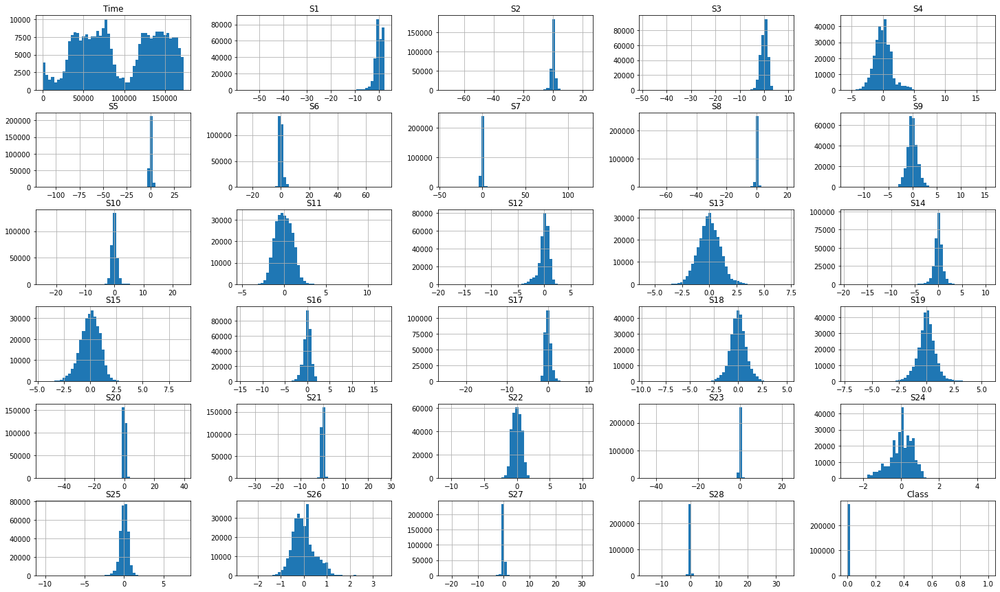

time: 6.57 s


In [20]:
data.hist(bins=50, figsize=(25,15))
plt.show()

## Creating the Feature Matrix and Labels

In [21]:
#Splitting the data
dataX = data.copy().drop(['Class'],axis=1)
dataY = data['Class'].astype(int).copy()

time: 76.2 ms


In [22]:
#Checking the labels
dataY.value_counts()

0    284315
1       492
Name: Class, dtype: int64

time: 10.4 ms


## Feature Standardization: Rescaling the Data

Feature engineering is an inseparable aspect of ML models. In many engineering problem, we know from our tradition that combining different features significantly simplifies the problem and help us to focus our experimental / numerical work on the correct data plane. For example, we combine characteristic length, velocity, density and viscosity as Reynolds number and "classify" the flow regime in a pipe in a quite straight-forward way. The same is true on ML algorithms. You can combine features, delete the unrelated ones and rescale the data (similar to what we do in non-dimensional analysis in engineering) to help ML algorithms to seek patterns from an unbiased perspective. 

For the time being, lets just see how much the features are correlated. But first, we will rescale the data. It is  important to remember that most ML algorithms work better if the data is normalized around zero; that it has a mean value of zero with a standard deviation of one. Let's try it ourselves:

In [23]:
#Rescaling the data
featuresToScale = dataX.columns
sX = pp.StandardScaler(copy=True)
dataX.loc[:,featuresToScale] = sX.fit_transform(dataX[featuresToScale])
#Looking into the statistics again:
dataX.describe()

,Time,S1,S2,S3,S4,S5,S6,S7,S8,S9,S10,S11,S12,S13,S14,S15,S16,S17,S18,S19,S20,S21,S22,S23,S24,S25,S26,S27,S28
count,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05
mean,-1.050379e-14,-1.536091e-15,-3.693350e-16,-2.082561e-15,9.153351e-16,5.854865e-18,2.784804e-16,2.636489e-16,2.820733e-16,1.465833e-16,9.990241e-17,-6.106607e-16,1.408301e-15,4.043764e-16,1.110118e-16,2.075961e-15,-9.586821e-17,3.840856e-16,3.894075e-16,-4.477913e-17,-5.225632e-16,1.308865e-16,-8.043247e-16,-6.657393e-17,1.487786e-16,-4.774076e-16,-3.018009e-16,3.521028e-17,-4.119621e-17
std,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00
min,-1.996583e+00,-2.879855e+01,-4.403529e+01,-3.187173e+01,-4.013919e+00,-8.240810e+01,-1.963606e+01,-3.520940e+01,-6.130252e+01,-1.222802e+01,-2.258191e+01,-4.700128e+00,-1.869868e+01,-5.819392e+00,-2.004428e+01,-4.915191e+00,-1.612534e+01,-2.962645e+01,-1.133266e+01,-8.861402e+00,-7.069146e+01,-4.741907e+01,-1.506565e+01,-7.175446e+01,-4.683638e+00,-1.975033e+01,-5.401098e+00,-5.590660e+01,-4.674612e+01
25%,-8.552120e-01,-4.698918e-01,-3.624707e-01,-5.872142e-01,-5.993788e-01,-5.010686e-01,-5.766822e-01,-4.478860e-01,-1.746805e-01,-5.853631e-01,-4.917360e-01,-7.470224e-01,-4.058964e-01,-6.516198e-01,-4.439565e-01,-6.368132e-01,-5.341353e-01,-5.695609e-01,-5.951621e-01,-5.605369e-01,-2.746334e-01,-3.109433e-01,-7.473476e-01,-2.591784e-01,-5.854676e-01,-6.084001e-01,-6.780717e-01,-1.755053e-01,-1.604440e-01
50%,-2.131453e-01,9.245351e-03,3.965683e-02,1.186124e-01,-1.401724e-02,-3.936682e-02,-2.058046e-01,3.241723e-02,1.871982e-02,-4.681169e-02,-8.533551e-02,-3.209268e-02,1.401448e-01,-1.363250e-02,5.278702e-02,5.251917e-02,7.579255e-02,-7.732604e-02,-4.338370e-03,4.588014e-03,-8.104705e-02,-4.009429e-02,9.345377e-03,-1.792420e-02,6.765678e-02,3.183240e-02,-1.081217e-01,3.325174e-03,3.406368e-02
75%,9.372174e-01,6.716939e-01,4.867202e-01,6.774569e-01,5.250082e-01,4.433465e-01,2.991625e-01,4.611107e-01,2.740785e-01,5.435305e-01,4.168842e-01,7.245863e-01,6.187332e-01,6.656518e-01,5.144513e-01,7.088502e-01,5.971989e-01,4.705737e-01,5.974968e-01,5.637928e-01,1.725733e-01,2.537392e-01,7.283360e-01,2.364319e-01,7.257153e-01,6.728006e-01,4.996663e-01,2.255648e-01,2.371526e-01
max,1.642058e+00,1.253351e+00,1.335775e+01,6.187993e+00,1.191874e+01,2.521413e+01,5.502015e+01,9.747824e+01,1.675153e+01,1.419494e+01,2.180758e+01,1.177504e+01,7.854679e+00,7.160735e+00,1.098147e+01,9.699117e+00,1.976044e+01,1.089502e+01,6.014342e+00,6.869414e+00,5.113464e+01,3.703471e+01,1.447304e+01,3.607668e+01,7.569684e+00,1.442532e+01,7.293975e+00,7.831940e+01,1.025434e+02


time: 719 ms


As you can see, mean value is fixed as zero with a standard deviation (std) of 1. Now let's try to visualize how correlated the data is by creating a correlation matrix. 

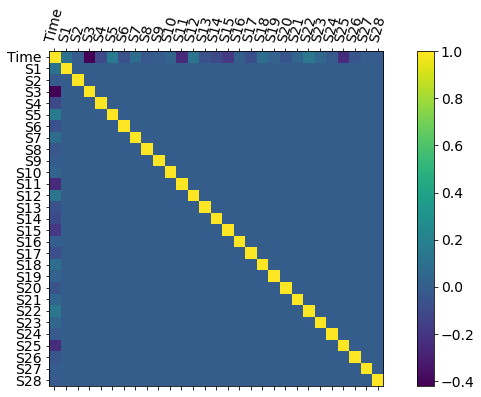

time: 989 ms


In [24]:
correlationMatrix = pd.DataFrame(dataX).corr() 

f = plt.figure(figsize=(12, 6))
plt.matshow(correlationMatrix, fignum=f.number)
plt.xticks(range(dataX.shape[1]), dataX.columns, fontsize=14, rotation=75)
plt.yticks(range(dataX.shape[1]), dataX.columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.show()

In [25]:
#we can also simply look at the table via pandas:
correlationMatrix.style.background_gradient(cmap='viridis').set_precision(2)

,Time,S1,S2,S3,S4,S5,S6,S7,S8,S9,S10,S11,S12,S13,S14,S15,S16,S17,S18,S19,S20,S21,S22,S23,S24,S25,S26,S27,S28
Time,1.00,0.12,-0.01,-0.42,-0.11,0.17,-0.06,0.08,-0.04,-0.01,0.03,-0.25,0.12,-0.07,-0.10,-0.18,0.01,-0.07,0.09,0.03,-0.05,0.04,0.14,0.05,-0.02,-0.23,-0.04,-0.01,-0.01
S1,0.12,1.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,-0.00
S2,-0.01,0.00,1.00,0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00
S3,-0.42,-0.00,0.00,1.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,0.00
S4,-0.11,-0.00,-0.00,0.00,1.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00
S5,0.17,-0.00,-0.00,-0.00,-0.00,1.00,-0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00
S6,-0.06,-0.00,0.00,-0.00,0.00,-0.00,1.00,-0.00,-0.00,0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,-0.00
S7,0.08,-0.00,0.00,0.00,0.00,0.00,-0.00,1.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00
S8,-0.04,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,1.00,-0.00,-0.00,0.00,-0.00,0.00,-0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00
S9,-0.01,0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,1.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,0.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00


time: 209 ms


*It looks like there is not a correlation in the dataset at all! Why do you think that is the case?*


**What do these numbers mean?**

When it is close to 1, it means that there is a strong positive correlation; At the other extreme; –1, it implies that there is a strong negative correlation. For more:

https://en.wikipedia.org/wiki/Correlation_and_dependence

## Preparing the Dataset for Model

We need to divide our entire dataset into fractions so that we have a training set
from which the machine learning algorithm learns. We also need another set to test the predictions of the ML algorithm. There is no golden rule here: you need to consider the size of your entire dataset. Sometimes 5% is more than enough, sometimes we need to divide 1/3 to have enough test samples. 





In [26]:
X_train, X_test, y_train, y_test = train_test_split(dataX, dataY, test_size=0.33,random_state=2018, stratify=dataY)

time: 235 ms


Here we have frozen the randomness to make the results reproducible. Otherwise, the results would change at every run.

Note that we will use dataY only to validate the results, not to train with the algorithm as we did in supervised machine
learning problems. 

# Evaluation Tools

## Anomaly Score

In principle, dimensionality reduction algorithms
reduce the dimensionality of data while attempting to minimize the reconstruction error; that is, the algorithm will extract pattern with the data and use them to recover its original form. If there is anomaly in the data, such as manufacturing errors, they will be the hardest to recover. We can use this idea to build up a score for anomaly detection.

We can consider it as the **approximation or reconstruction error**. 

It can be expressed as the sum of the squared differences between the original feature matrix and the reconstructed matrix using the dimensionality reduction algorithm. We will define such a function **in two steps**:

In [27]:
def anomalyScore (originalDF, reducedDF):
  #Calculating the sum of the square of residuals:
  loss = np.sum((np.array(originalDF)-np.array(reducedDF))**2, axis=1)
  # If you are confused about the summation axis, check the following link:
  # https://www.sharpsightlabs.com/blog/numpy-axes-explained/
  loss = pd.Series(data=loss,index=originalDF.index)
  #Normalizing the results: The idea is to mimic the labels (the best ones will be zero, the worst case will be 1)
  loss = (loss-np.min(loss))/(np.max(loss)-np.min(loss))
  return loss

time: 6.17 ms


After obtaining the anomaly score, we can use it to construct a precision-recall curve by comparing its predictions to the labels of the dataset.

In [28]:
def plotResults(trueLabels, anomalyScore, returnPreds = False, plotting = True):
  #preparing the dataframe:
  preds = pd.concat([trueLabels, anomalyScore], axis=1)
  preds.columns = ['trueLabel', 'anomalyScore']
  
  #Calculate the precision, recall, thresholds:
  precision, recall, thresholds = \
  precision_recall_curve(preds['trueLabel'],preds['anomalyScore'])
  
  #Calculate the average precision:
  average_precision = average_precision_score(preds['trueLabel'],preds['anomalyScore'])
  if plotting:
    #Plotting the results:
    plt.step(recall, precision, color='b', alpha=0.7, where='post')
    plt.fill_between(recall, precision, step='post', alpha=0.3, color='b')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.ylim([0.0, 1.1])
    plt.xlim([0.0, 1.0])
    plt.title('Average Precision = {0:0.2f}'.format(average_precision))

  #Do you need the preds?
  if returnPreds==True:
    return preds, average_precision

time: 23.4 ms


## Data Visualization

In order to see the segragation between the cases, we will use a scatter plot in 2D and 3D (after dimensionality reduction) for the visualization purposes.

In [29]:
def scatterPlot(x_DF, y_DF, methodName):
  #Filtering the first two columns (first two dimensions):
  df = pd.DataFrame(data=x_DF.loc[:,0:1], index=x_DF.index)
  #Adding the labels:
  df = pd.concat((df,y_DF), axis=1, join="inner")
  #Labeling the columns
  df.columns = ["First Dimension", "Second Dimension", "Label"]
  sns.lmplot(x="First Dimension", y="Second Dimension", hue="Label", data=df, fit_reg=False)
  ax = plt.gca()
  ax.set_title("Visualization of the data segragation using "+methodName)

time: 7.73 ms


In [30]:
def scatterPlot3D(x_DF, y_DF, methodName):
  #Filtering the first two columns (first three dimensions):
  df = pd.DataFrame(data=x_DF.loc[:,0:2], index=x_DF.index)
  #Adding the labels:
  df = pd.concat((df,y_DF), axis=1, join="inner")
  #Labeling the columns
  df.columns = ["First Dimension", "Second Dimension","Third Dimension", "Label"]

  # Plotting the figure:
  fig = px.scatter_3d(df, x='First Dimension', y='Second Dimension', z='Third Dimension',\
                      color='Label', symbol='Label', opacity=0.7, \
                      color_continuous_scale=px.colors.sequential.Viridis,
                      width = 600,
                      height = 500) 

  #https://plotly.com/python/reference/layout/#layout-transition
  title = "Visualization of the data segragation using "+methodName
  fig.update_layout(title_text=title, showlegend = True, hovermode = False)
  fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
  fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01))

  fig.show() 

time: 17.1 ms


# 1. Anomaly detection with PCA

The **anomaly** score will depend mainly on the **number of principal components**: as the number is increased, it will learn more about the data and eventually cover the anormalies as well. Therefore, we need to **find the right number of PC**, similar to the strategy we followed in clustering. 

As a rule of thumb, PCA will yield the optimum variance if the number of PC is equal to its dimensions. Lets see whether this is the case or not for ourselves! 

**Note:**

Remember that PCA assumes the dataset is centered around the origin. This is done by default in scikit learn but if you implement PCA yourself, you must not forget to center the data around zero first.

Another important parameter is scaling. In scikit, PCA centers but does not scale the input data for each feature before applying the SVD. The optional parameter `whiten=True` makes it possible to project the data onto the singular space while scaling each component to unit variance.

In [31]:
#https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html
#-----------------
# Hyperparameters:
#-----------------
# if n_components is not set all components are kept: n_components == min(n_samples, n_features)
n_components = 29
# Whitening will remove some information from the transformed signal
# but can sometime improve the predictive accuracy of the downstream estimators. 
whiten = False #Default option
#If auto, the solver is selected by a default policy based on X.shape and n_components:
svd_solver = 'auto'
#Random state for reproducibility:
random_state = 2020

pca = PCA(n_components=n_components, whiten=whiten, svd_solver = svd_solver, random_state=random_state)

time: 4.61 ms


In [32]:
# Model Implementation:

#Fit the model with X and apply the dimensionality reduction on X
X_train_PCA = pca.fit_transform(X_train)
# Organizing the data:
X_train_PCA = pd.DataFrame(data=X_train_PCA, index=X_train.index)

#Transform data back to its original space:
X_train_PCA_inverse = pca.inverse_transform(X_train_PCA)
# Organizing the data:
X_train_PCA_inverse = pd.DataFrame(data=X_train_PCA_inverse, index=X_train.index)

time: 558 ms


## Variance ratio

We can look into importance of individual components via variance ratio methods:

In [33]:
# Variance ratio explained by each of the selected components
print(pca.explained_variance_ratio_)

[0.05782536 0.03735246 0.037053   0.0360517  0.03553731 0.03523222
 0.03471402 0.03465545 0.03462662 0.03454945 0.03451214 0.03447077
 0.03446788 0.0343717  0.03433423 0.03433041 0.03428126 0.0342399
 0.03423109 0.0341809  0.03414469 0.03407807 0.03407367 0.03400179
 0.03393317 0.03368608 0.03232922 0.03189804 0.01083739]
time: 2.05 ms


You can select the number of dimensions for data compression by looking into the variance: 

you can keep *x* number of components adding up to a sufficiently large por tion of the variance such as 90 / 95%. 

## Visualizing the results:

In [34]:
X_train_PCA.sample(2)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28
221638,-1.477778,-0.033678,-0.045914,0.037517,0.033220,-0.226575,0.510750,0.186315,-0.553044,-0.480188,-0.010104,1.155390,-0.883390,-0.411805,-0.442081,-0.754004,0.452742,-0.572860,-0.097503,0.509565,-0.266121,0.813440,-0.22243,0.687179,0.026494,-0.131330,-0.303884,-0.036106,0.063095
159516,-0.664289,-0.063790,-0.135762,0.205772,0.168689,0.204739,-0.618344,0.671721,1.430658,1.279862,0.215643,1.847998,0.401269,-1.017862,0.603969,-1.079613,-0.701653,0.073774,-0.173843,-0.194131,-1.919116,0.675403,-1.52203,-0.926953,1.836209,-0.168201,-0.491337,-0.004338,0.149903


time: 83 ms


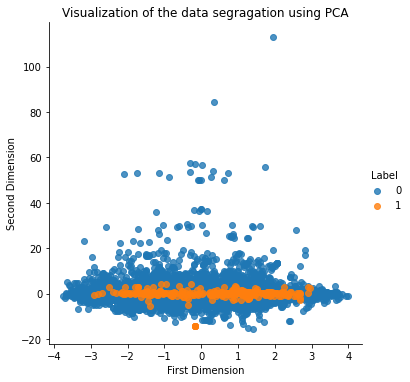

time: 1.92 s


In [35]:
#Calling our scattering function:
scatterPlot(X_train_PCA, y_train, "PCA")

In [84]:
#Calling our scattering function:
scatterPlot3D(X_train_PCA, y_train, "PCA")

time: 2.16 s


Lets investigate the anomaly score via PR curve.

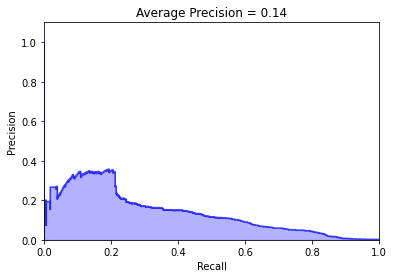

time: 1.04 s


In [37]:
anomalyScorePCA = anomalyScore(X_train, X_train_PCA_inverse)
predsPCA = plotResults(y_train, anomalyScorePCA, False, True)

As we can see from the average score, the anomaly detection fails with high number of PCA, as expected.

## Optimizing Number of Dimensions for Anomaly Detection

Lets do a grid search like analysis to determine the `n_components`. 

See also:

https://scikit-learn.org/stable/auto_examples/compose/plot_compare_reduction.html

if you have a downstream app.

In [38]:
#https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html
#-----------------
# Hyperparameters:
#-----------------
# Whitening will remove some information from the transformed signal
# but can sometime improve the predictive accuracy of the downstream estimators. 
whiten = False #Default option
#If auto, the solver is selected by a default policy based on X.shape and n_components:
svd_solver = 'auto'
#Random state for reproducibility:
random_state = 2020

time: 6.86 ms


In [39]:
# Model Implementation:

n_components_list = np.arange(2,30,1)
precision_list = []

for n_components in n_components_list:
  #Model description:
  pca = PCA(n_components=n_components, whiten=whiten, svd_solver = svd_solver, random_state=random_state)
  #Fit the model with X and apply the dimensionality reduction on X
  X_train_PCA = pca.fit_transform(X_train)
  # Organizing the data:
  X_train_PCA = pd.DataFrame(data=X_train_PCA, index=X_train.index)

  #Transform data back to its original space:
  X_train_PCA_inverse = pca.inverse_transform(X_train_PCA)
  # Organizing the data:
  X_train_PCA_inverse = pd.DataFrame(data=X_train_PCA_inverse, index=X_train.index)

  anomalyScorePCA = anomalyScore(X_train, X_train_PCA_inverse)
  predsPCA, average_precision_i  = plotResults(y_train, anomalyScorePCA, True, False)
  precision_list.append(average_precision_i)

time: 36.2 s


Text(0.5, 1.0, 'Variation of Average Precision with # Component')

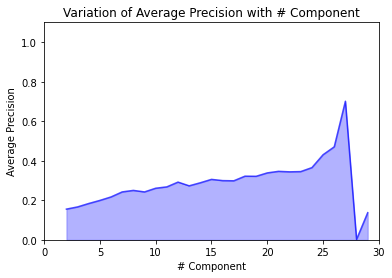

time: 193 ms


In [40]:
# Plotting Results

plt.plot(n_components_list, precision_list, color='b', alpha=0.7)
plt.fill_between(n_components_list, precision_list, alpha=0.3, color='b')
plt.xlabel('# Component')
plt.ylabel('Average Precision')
plt.ylim([0.0, 1.1])
plt.xlim([0.0, 30.0])
plt.title('Variation of Average Precision with # Component')

In [41]:
n_components_best = n_components_list[precision_list.index(max(precision_list))]
print('Best number of component is ',n_components_best)

Best number of component is  27
time: 2.94 ms


In [42]:
n_components_worst = n_components_list[precision_list.index(min(precision_list))]
print('Worst number of component for anomaly detection is ',n_components_worst)

Worst number of component for anomaly detection is  28
time: 2.99 ms


## Looking into the Best Case for Anomaly Detection

In [43]:
#https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html
#-----------------
# Hyperparameters:
#-----------------
# if n_components is not set all components are kept: n_components == min(n_samples, n_features)
n_components = n_components_best
# Whitening will remove some information from the transformed signal
# but can sometime improve the predictive accuracy of the downstream estimators. 
whiten = False #Default option
#If auto, the solver is selected by a default policy based on X.shape and n_components:
svd_solver = 'auto'
#Random state for reproducibility:
random_state = 2020

pca = PCA(n_components=n_components, whiten=whiten, svd_solver = svd_solver, random_state=random_state)

time: 6.63 ms


In [44]:
# Model Implementation:

#Fit the model with X and apply the dimensionality reduction on X
X_train_PCA = pca.fit_transform(X_train)
# Organizing the data:
X_train_PCA = pd.DataFrame(data=X_train_PCA, index=X_train.index)

#Transform data back to its original space:
X_train_PCA_inverse = pca.inverse_transform(X_train_PCA)
# Organizing the data:
X_train_PCA_inverse = pd.DataFrame(data=X_train_PCA_inverse, index=X_train.index)

time: 465 ms


## Visualizing the results:

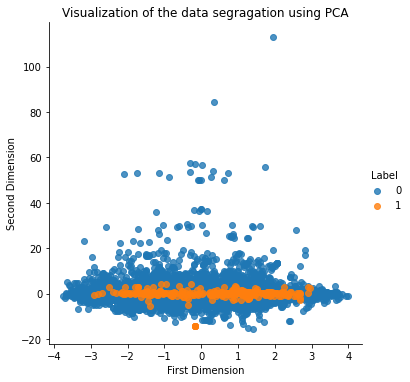

time: 1.95 s


In [45]:
#Calling our scattering function:
scatterPlot(X_train_PCA, y_train, "PCA")

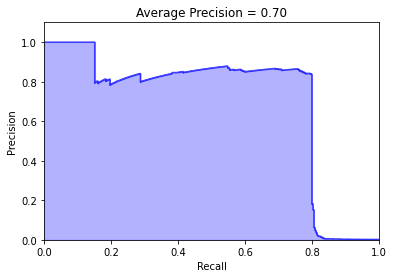

time: 640 ms


In [46]:
anomalyScorePCA = anomalyScore(X_train, X_train_PCA_inverse)
predsPCA = plotResults(y_train, anomalyScorePCA, False, True)

# Incremental PCA

One problem with the preceding implementations of PCA is that they require the whole training set to fit in memory in order for the algorithm to run. Fortunately,
Incremental PCA (IPCA) algorithms have been developed. They allow you to split the training set into mini-batches and feed an IPCA algorithm one mini-batch at a time.

If needed, check:

https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.IncrementalPCA.html#sklearn.decomposition.IncrementalPCA


# Anomaly Detection with kPCA

KernelPCA is an extension of PCA which achieves non-linear dimensionality reduction through the use of kernels. It is very, very slow so we need to reduce the data volume drastically to run it in the lecture.



In [47]:
# Reducing the volume of the data:
X_train, X_test, y_train, y_test = train_test_split(dataX,dataY, test_size=0.96,random_state=2020, stratify=dataY)

time: 201 ms


In [48]:
# Kernel PCA

#https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.KernelPCA.html
#-----------------
# Hyperparameters:
#-----------------
# if n_components is not set all components are kept: n_components == min(n_samples, n_features)
n_components = n_components_best
# Kernel selection: “linear” | “poly” | “rbf” | “sigmoid” | “cosine” | “precomputed”
kernel = 'rbf'
#Learn the inverse transform for non-precomputed kernels:
fit_inverse_transform = True 
#Random state for reproducibility:
random_state = 2020

kpca = KernelPCA(n_components=n_components, kernel=kernel, fit_inverse_transform = fit_inverse_transform, random_state=random_state)

time: 4.3 ms


In [49]:
# Model Implementation:

#Fit the model with X and apply the dimensionality reduction on X
X_train_kPCA = kpca.fit_transform(X_train)
# Organizing the data:
X_train_kPCA = pd.DataFrame(data=X_train_kPCA, index=X_train.index)

#Transform data back to its original space:
X_train_kPCA_inverse = kpca.inverse_transform(X_train_kPCA)
# Organizing the data:
X_train_kPCA_inverse = pd.DataFrame(data=X_train_kPCA_inverse, index=X_train.index)

time: 4min 32s


## Visualization of the Anomaly Score

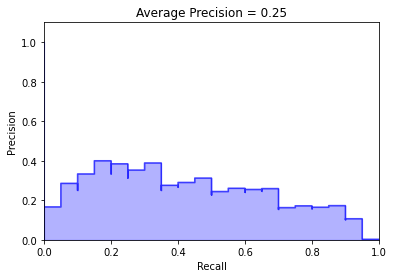

time: 224 ms


In [50]:
anomalyScorekPCA = anomalyScore(X_train, X_train_kPCA_inverse)
predskPCA = plotResults(y_train, anomalyScorekPCA, False, True)

## Visualizing the results:

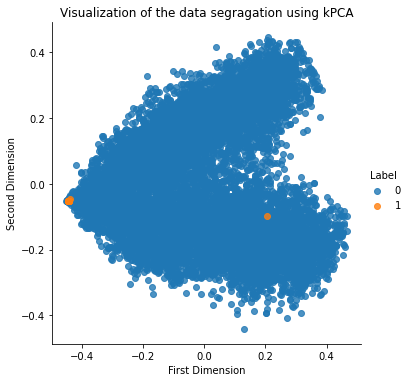

time: 472 ms


In [51]:
#Calling our scattering function:
scatterPlot(X_train_kPCA, y_train, "kPCA")

In [83]:
#Calling our scattering function:
scatterPlot3D(X_train_kPCA, y_train, "kPCA")

time: 580 ms


# Manifold learning 

Manifold learning is an approach to non-linear dimensionality reduction. It generalizes the linear frameworks like PCA to be sensitive to non-linear structure in data. Though supervised variants exist, the typical manifold learning problem is unsupervised: it learns the high-dimensional structure of the data from the data itself, without the use of predetermined classifications.

https://scikit-learn.org/stable/modules/manifold.html

## Isometric Mapping

One of the earliest approaches to manifold learning is the Isomap algorithm and it is somehow an extension of the kernel PCA. 

In this method, the algorithm calculates the pairwise distances, hence learns the intrinsic geometry of the original data by using the relative distances to the neighbors on a manifold. 

In [53]:
# Isomap 
#https://scikit-learn.org/stable/modules/generated/sklearn.manifold.Isomap.html
#-----------------
# Hyperparameters:
#-----------------
#number of neighbors to consider for each point:
n_neighbors = 5
#number of coordinates for the manifold:
n_components = 10
#eigen_solver [‘auto’|’arpack’|’dense’]
eigen_solver='auto'
#neighbors_algorithm [‘auto’|’brute’|’kd_tree’|’ball_tree’]
neighbors_algorithm='auto'

isomap = Isomap(n_neighbors=n_neighbors,n_components=n_components, eigen_solver=eigen_solver,neighbors_algorithm=neighbors_algorithm)

time: 3.66 ms


In [54]:
# Model Implementation:

#Fit the model with X and apply the dimensionality reduction on X
X_train_iso = isomap.fit_transform(X_train)
# Organizing the data:
X_train_iso = pd.DataFrame(data=X_train_iso, index=X_train.index)

#Transform data back to its original space:
# Note that 'Isomap' object has no attribute 'inverse_transform'.


time: 5min 35s


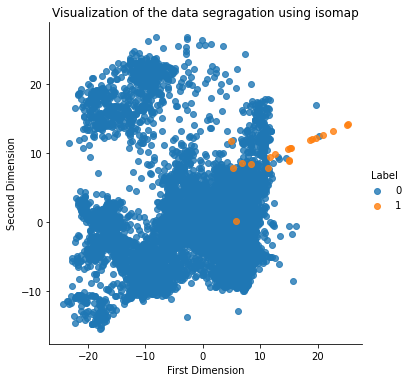

time: 514 ms


In [55]:
#Calling our scattering function:
scatterPlot(X_train_iso, y_train, "isomap")

In [56]:
#Calling our scattering function:
scatterPlot3D(X_train_iso, y_train, "Isomap")

time: 444 ms


## Locally Linear Embedding

Locally linear embedding (LLE) seeks a lower-dimensional projection of the data which preserves distances within local neighborhoods. It can be thought of as a series of local PCA.

The algorithm segments the data into smaller components and model each component as a linear embedding.

In [57]:
# LLE 
#https://scikit-learn.org/stable/modules/generated/sklearn.manifold.locally_linear_embedding.html
#-----------------
# Hyperparameters:
#-----------------
#number of neighbors to consider for each point:
n_neighbors = 10
#number of coordinates for the manifold:
n_components = 3
#method {‘standard’, ‘hessian’, ‘modified’, ‘ltsa’}
method = 'modified'
#Random state:
random_state = 2020

lle = LocallyLinearEmbedding(n_neighbors=n_neighbors,n_components=n_components, method=method, random_state=random_state)

time: 4.16 ms


In [58]:
# Model Implementation:

#Fit the model with X and apply the dimensionality reduction on X
lle.fit(X_train)
X_train_lle = lle.transform(X_train)
# Organizing the data:
X_train_lle = pd.DataFrame(data=X_train_lle, index=X_train.index)

#Transform data back to its original space:
#'LocallyLinearEmbedding' object has no attribute 'inverse_transform'

time: 1min 30s


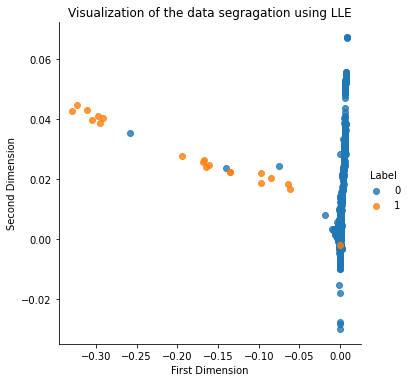

time: 470 ms


In [59]:
#Calling our scattering function:
scatterPlot(X_train_lle, y_train, "LLE")

In [60]:
X_train_lle.sample(2)

,0,1,2
104827,-0.000125,-0.002044,-0.000590
153511,0.005509,0.030178,0.002032


time: 18.9 ms


In [82]:
#Calling our scattering function:
scatterPlot3D(X_train_lle, y_train, "LLE")

time: 407 ms


## t-SNE: t-Distributed Stochastic Neighbor Embedding

The algorithm models each high-dimensional point into a two- or threedimensional space, where similar points are modeled close to each other and dissimilar points are modeled farther away. 


In [62]:
# t-SNE 
#https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html
#-----------------
# Hyperparameters:
#-----------------
#Dimension of the embedded space:
n_components = 3
# LR:  usually in the range [10.0, 1000.0]. 
# If the learning rate is too high, the data may look like a ‘ball’ with any point 
# approximately equidistant from its nearest neighbours. 
learning_rate = 300
#perplexity is related to the number of nearest neighbors. Consider selecting a value between 5 and 50. 
perplexity = 30
# early_exaggeration controls how tight natural clusters in the original space are in the embedded space 
# and how much space will be between them.
early_exaggeration = 12
# Initialization of embedding. Possible options are ‘random’, ‘pca’
init = 'random'
#Random state:
random_state = 2020

tSNE = TSNE(n_components=n_components, learning_rate=learning_rate, perplexity=perplexity, early_exaggeration=early_exaggeration, init=init, random_state=random_state)

time: 5.54 ms


In [63]:
# Model Implementation:

#Fit the model with X and apply the dimensionality reduction on X
X_train_tSNE = tSNE.fit_transform(X_train)
# Organizing the data:
X_train_tSNE = pd.DataFrame(data=X_train_tSNE, index=X_train.index)

#Transform data back to its original space:
# Note that 'tSNE' object has no attribute 'inverse_transform'.


time: 8min 40s


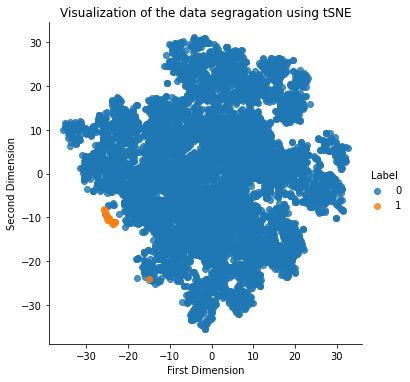

time: 605 ms


In [64]:
#Calling our scattering function:
scatterPlot(X_train_tSNE, y_train, "tSNE")

In [65]:
#Calling our scattering function:
scatterPlot3D(X_train_tSNE, y_train, "tSNE")

time: 612 ms


## Multi-dimensional Scaling (MDS)

In general, MDS is a technique used for analyzing similarity or dissimilarity data. It attempts to model similarity or dissimilarity data as distances in a geometric spaces. The data can be ratings of similarity between objects, interaction frequencies of molecules, or trade indices between countries.

There exists two types of MDS algorithm: metric and non metric. In the scikit-learn, the class MDS implements both. 



In [66]:
# MDS 
#https://scikit-learn.org/stable/modules/generated/sklearn.manifold.MDS.html
#-----------------
# Hyperparameters:
#-----------------
# Number of dimensions in which to immerse the dissimilarities.
n_components = 3
# Number of times the SMACOF algorithm will be run with different initializations. 
# The final results will be the best output of the runs
n_init = 5
# Maximum number of iterations of the SMACOF algorithm for a single run.
max_iter = 500
#Metric: if True, perform metric MDS; otherwise, perform nonmetric MDS.
metric = True
#dissimilarity ‘euclidean’ | ‘precomputed’, default: ‘euclidean’
dissimilarity = 'euclidean'
#Random state:
random_state = 2020

mds = MDS(n_components=n_components, n_init=n_init, max_iter=max_iter, metric=metric, dissimilarity=dissimilarity, random_state=random_state)

time: 8.49 ms


In [67]:
# Model Implementation:

#Important Note:
# MDS has O(N^3) complexity so it is very very slow for large martices. 
# If you are going to run it, it would take a significant amount of time.

#Fit the model with X and apply the dimensionality reduction on X
#X_train_MDS = mds.fit_transform(X_train)
# Organizing the data:
#X_train_MDS = pd.DataFrame(data=X_train_MDS, index=X_train.index)

#Transform data back to its original space:
# Note that 'MDS' object has no attribute 'inverse_transform'.


time: 2.07 ms


In [68]:
#Calling our scattering function:
#scatterPlot(X_train_MDS, y_train, "MDS")

time: 951 µs


In [69]:
#Calling our scattering function:
#scatterPlot3D(X_train_MDS, y_train, "MDS")

time: 760 µs


# Dictionary Learning

Dictionary learning derives the sparse representation
of the original data. The resulting matrix is known as the dictionary, and the vectors in the dictionary are known as atoms. These atoms are simple, binary vectors (zeros and ones), where each instance in the original data can be
reconstructed as a weighted sum of these atoms.

Assuming there are m features in the original data and n atoms in the dictionary,we can achieve dim. reduction if n < m. This is what we will do here for dim. reduction but it works for n > m as well. 

`MiniBatchDictionaryLearning` implements a faster, but less accurate version of the dictionary learning algorithm that is better suited for large datasets.

By default, `MiniBatchDictionaryLearning` divides the data into mini-batches and optimizes in an online manner by cycling over the mini-batches for the specified number of iterations.

In [70]:
# Reducing the volume of the data:
X_train, X_test, y_train, y_test = train_test_split(dataX,dataY, test_size=0.33,random_state=2018, stratify=dataY)

time: 275 ms


In [71]:
# Mini Batch Dictionary Learning  
#https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.MiniBatchDictionaryLearning.html
#-----------------
# Hyperparameters:
#-----------------
# number of dictionary elements to extract
n_components = 3
# sparsity controlling parameter:
alpha = 0.1
#Number of samples in each mini-batch
batch_size = 200
# total number of iterations to perfom:
n_iter = 50
# Fitting:
# lars: uses the least angle regression method 
# cd: uses the coordinate descent method to compute the Lasso solution 
# Lars will be faster if the estimated components are sparse.
fit_algorithm='lars'
#Random state:
random_state = 2020

miniBatchDictLearning = MiniBatchDictionaryLearning(n_components=n_components, alpha=alpha, batch_size=batch_size, n_iter=n_iter, fit_algorithm=fit_algorithm, random_state=random_state)

time: 6.23 ms


In [72]:
# Model Implementation:

#Fit the model with X and apply the dimensionality reduction on X
X_train_mDict = miniBatchDictLearning.fit_transform(X_train)
# Organizing the data:
X_train_mDict = pd.DataFrame(data=X_train_mDict, index=X_train.index)

#Transform data back to its original space:
# Note that 'miniBatchDictLearning' object has no attribute 'inverse_transform'.

time: 19.8 s


In [73]:
# Inverse X Calculation for Dictionary Learning
X_train_mDict_inverse = np.array(X_train_mDict).dot(miniBatchDictLearning.components_)
X_train_mDict_inverse = pd.DataFrame(data=X_train_mDict_inverse,index=X_train.index)

anomalyScoresMiniBatchDictLearning = anomalyScore(X_train, X_train_mDict_inverse)

time: 87.5 ms


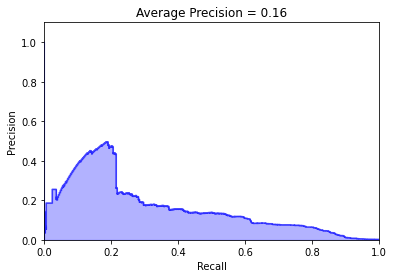

time: 596 ms


In [74]:
anomalyScore_mDict = anomalyScore(X_train, X_train_mDict_inverse)
predskPCA = plotResults(y_train, anomalyScore_mDict, False, True)

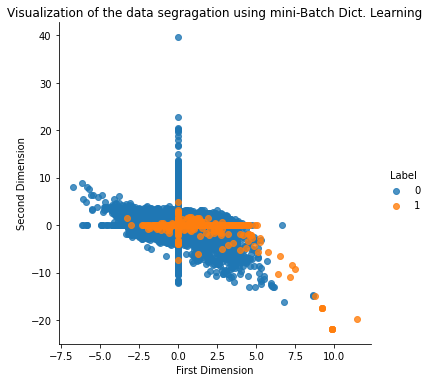

time: 1.89 s


In [75]:
#Calling our scattering function:
scatterPlot(X_train_mDict, y_train, "mini-Batch Dict. Learning")

In [76]:
#Calling our scattering function:
scatterPlot3D(X_train_mDict, y_train, "mini-Batch Dict. Learning")

time: 2.11 s


# ICA: Independent Component Analysis

Independent component analysis separates a multivariate signal into additive subcomponents that are maximally independent. It is implemented in scikit-learn using the `FastICA` algorithm. 

Typically, ICA is not used for reducing dimensionality but for separating superimposed signals (voice recognition in a busy street). Since the ICA model does not include a noise term, for the model to be correct, whitening must be applied. This can be done internally using the whiten argument.

In [77]:
# ICA
#https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.FastICA.html
#-----------------
# Hyperparameters:
#-----------------
#Number of components to use. If none is passed, all are used:
n_components = 27
#algorithm{‘parallel’, ‘deflation’}:
algorithm = 'parallel'
#If whiten is false, the data is already considered to be whitened, and no whitening is performed:
whiten = True
#Maximum number of iterations during fit:
max_iter = 100
#Random state:
random_state = 2020

fastICA = FastICA(n_components=n_components, algorithm=algorithm, whiten=whiten, max_iter=max_iter, random_state=random_state)

time: 5.09 ms


In [78]:
# Model Implementation:

#Fit the model with X and apply the dimensionality reduction on X
X_train_fastICA = fastICA.fit_transform(X_train)
# Organizing the data:
X_train_fastICA = pd.DataFrame(data=X_train_fastICA, index=X_train.index)

#Transform data back to its original space:
X_train_fastICA_inverse = fastICA.inverse_transform(X_train_fastICA)
# Organizing the data:
X_train_fastICA_inverse = pd.DataFrame(data=X_train_fastICA_inverse, index=X_train.index)

time: 15.8 s


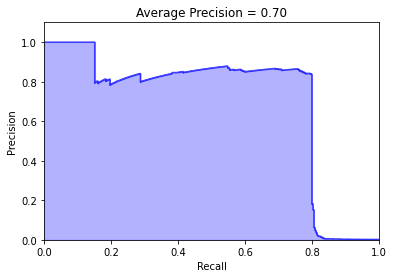

time: 627 ms


In [79]:
anomalyScorefastICA = anomalyScore(X_train, X_train_fastICA_inverse)
predsPCA = plotResults(y_train, anomalyScorefastICA, False, True)

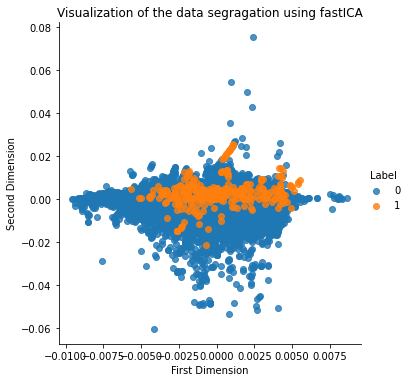

time: 1.91 s


In [80]:
#Calling our scattering function:
scatterPlot(X_train_fastICA, y_train, "fastICA")

In [81]:
#Calling our scattering function:
scatterPlot3D(X_train_fastICA, y_train, "fastICA")

time: 2.35 s


# Reading Material

https://scikit-learn.org/stable/modules/decomposition.html

https://ocw.mit.edu/courses/mathematics/18-650-statistics-for-applications-fall-2016/lecture-slides/MIT18_650F16_PCA.pdf

https://www.knime.com/blog/seven-techniques-for-data-dimensionality-reduction

http://cs229.stanford.edu/notes2020spring/cs229-notes10.pdf


